<a href="https://colab.research.google.com/github/dhanushkasisil2700/Binary-Prediction-of-Poisonous-Mushrooms/blob/main/Binary_Prediction_of_Poisonous_Mushrooms_ML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Install required packages**

In [1]:
pip install plotly opendatasets

**Import required packages**

In [2]:
import opendatasets as od
import pandas as pd
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

**Download Dataset**

In [3]:
if os.path.exists('test.csv'):
    print('test.csv is available')
else:
    url = "https://storage.googleapis.com/kaggle-competitions-data/kaggle-v2/76727/9045607/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1723026582&Signature=rheQRp66VEZnQFpns7LzJn%2Bfh3tItOGPSMjkPFSDOOYIFrUmhKXprI04CVjnn9WEqKdNWNQYiFkfUTbTR0TnS34S4zmqneHejsHBFiZcfmxkK0HYfGgloMLSBbRoEnfDF7CimGmU8WxAmMK5f6wafRMaa8EQZ3K4qBkKAuer%2BaoLGRGun%2FMxKJfRoU%2Bysi4OAGh7qywsT26Qju3O%2F6EMUAmsSfbVe8Qi2tqjqp7KMh6QMdgk6rXzvwbWoOYvg0UdV8%2BzvlCUZOVkfFGUpkmWc3BregQEFYIYihOjA0k9%2Bi5YmUt7msInQMAjrpOH6eb6PNzoiuqyFHBhlB9wSP5JOw%3D%3D&response-content-disposition=attachment%3B+filename%3Dplayground-series-s4e8.zip"
    od.download(url)

test.csv is available


In [4]:
import zipfile

with zipfile.ZipFile('playground-series-s4e8.zip', 'r') as zip_ref:
    zip_ref.extractall('.')

**Read data**

In [5]:
train_raw_data = pd.read_csv('train.csv')
test_raw_data = pd.read_csv('test.csv')

In [6]:
train_df = train_raw_data.copy()
test_df = test_raw_data.copy()

train_df = train_df.sample(frac=0.1, random_state=42)
test_df = test_df.sample(frac=0.1, random_state=42)

In [7]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 311694 entries, 1356763 to 1250267
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    311694 non-null  int64  
 1   class                 311694 non-null  object 
 2   cap-diameter          311694 non-null  float64
 3   cap-shape             311690 non-null  object 
 4   cap-surface           244437 non-null  object 
 5   cap-color             311693 non-null  object 
 6   does-bruise-or-bleed  311693 non-null  object 
 7   gill-attachment       259178 non-null  object 
 8   gill-spacing          185636 non-null  object 
 9   gill-color            311687 non-null  object 
 10  stem-height           311694 non-null  float64
 11  stem-width            311694 non-null  float64
 12  stem-root             36069 non-null   object 
 13  stem-surface          113645 non-null  object 
 14  stem-color            311692 non-null  object 
 15

**Clean Dataset**

In [8]:
(train_df.isna().sum() / 3116945) * 100

,0
id,0.000000
class,0.000000
cap-diameter,0.000000
cap-shape,0.000128
cap-surface,2.157786
cap-color,0.000032
does-bruise-or-bleed,0.000032
gill-attachment,1.684855
gill-spacing,4.044281
gill-color,0.000225


In [9]:
numerical_columns = train_df.select_dtypes(include=np.number).columns
categorical_columns = train_df.select_dtypes(exclude=np.number).columns

In [10]:
numerical_columns, categorical_columns

(Index(['id', 'cap-diameter', 'stem-height', 'stem-width'], dtype='object'),
 Index(['class', 'cap-shape', 'cap-surface', 'cap-color',
        'does-bruise-or-bleed', 'gill-attachment', 'gill-spacing', 'gill-color',
        'stem-root', 'stem-surface', 'stem-color', 'veil-type', 'veil-color',
        'has-ring', 'ring-type', 'spore-print-color', 'habitat', 'season'],
       dtype='object'))

In [11]:
train_df[numerical_columns].describe()

,id,cap-diameter,stem-height,stem-width
count,3.116940e+05,311694.000000,311694.000000,311694.000000
mean,1.560217e+06,6.313001,6.352213,11.168273
std,9.005508e+05,4.658714,2.704976,8.106814
min,1.200000e+01,0.400000,0.000000,0.000000
25%,7.773770e+05,3.320000,4.670000,4.990000
50%,1.561580e+06,5.760000,5.880000,9.670000
75%,2.341257e+06,8.240000,7.420000,15.650000
max,3.116940e+06,58.400000,53.930000,102.480000


In [12]:
train_df[numerical_columns].isna().sum() / 3116945 * 100

,0
id,0.0
cap-diameter,0.0
stem-height,0.0
stem-width,0.0


In [13]:
train_df["veil-type"].value_counts(dropna=False)

,count
veil-type,
NaN,295683
u,16001
w,2
e,2
c,2
f,2
g,1
a,1


In [14]:
train_df.drop(["veil-type"], axis=1, inplace=True)

In [15]:
train_df["spore-print-color"].value_counts(dropna=False)

,count
spore-print-color,
NaN,285110
k,10698
p,6756
w,5051
n,2207
r,798
u,736
g,323
c,3


In [16]:
train_df.drop(["spore-print-color"], axis=1, inplace=True)

In [17]:
train_df.drop(["veil-color"], axis=1, inplace=True)
train_df.drop(["stem-root"], axis=1, inplace=True)

In [18]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 311694 entries, 1356763 to 1250267
Data columns (total 18 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    311694 non-null  int64  
 1   class                 311694 non-null  object 
 2   cap-diameter          311694 non-null  float64
 3   cap-shape             311690 non-null  object 
 4   cap-surface           244437 non-null  object 
 5   cap-color             311693 non-null  object 
 6   does-bruise-or-bleed  311693 non-null  object 
 7   gill-attachment       259178 non-null  object 
 8   gill-spacing          185636 non-null  object 
 9   gill-color            311687 non-null  object 
 10  stem-height           311694 non-null  float64
 11  stem-width            311694 non-null  float64
 12  stem-surface          113645 non-null  object 
 13  stem-color            311692 non-null  object 
 14  has-ring              311693 non-null  object 
 15

**Imputing numerical columns**

In [19]:
#add into data frame
data = {'percentage': train_df.isna().sum() / 3116945 * 100,
        'type': train_df.dtypes}
pd.DataFrame(data)

,percentage,type
id,0.000000,int64
class,0.000000,object
cap-diameter,0.000000,float64
cap-shape,0.000128,object
cap-surface,2.157786,object
cap-color,0.000032,object
does-bruise-or-bleed,0.000032,object
gill-attachment,1.684855,object
gill-spacing,4.044281,object
gill-color,0.000225,object


In [20]:
train_df.drop(["id"], axis=1, inplace=True)

In [21]:
numerical_columns = train_df.select_dtypes(include=np.number).columns
categorical_columns = train_df.select_dtypes(exclude=np.number).columns

In [22]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean')
train_df[numerical_columns] = imputer.fit_transform(train_df[numerical_columns])

In [23]:
train_df[numerical_columns].isna().sum()

,0
cap-diameter,0
stem-height,0
stem-width,0


**Scaling numerical columns**

In [24]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
train_df[numerical_columns] = scaler.fit_transform(train_df[numerical_columns])

In [25]:
train_df[numerical_columns].describe()

,cap-diameter,stem-height,stem-width
count,311694.000000,311694.000000,311694.000000
mean,0.101948,0.117786,0.108980
std,0.080323,0.050157,0.079106
min,0.000000,0.000000,0.000000
25%,0.050345,0.086594,0.048692
50%,0.092414,0.109030,0.094360
75%,0.135172,0.137586,0.152713
max,1.000000,1.000000,1.000000


**Split dataset into training and validate**

In [26]:
from sklearn.model_selection import train_test_split

train_df, validate_df = train_test_split(train_df, test_size=0.2, random_state=42)

train_df.shape, validate_df.shape

((249355, 17), (62339, 17))

In [27]:
target_train = train_df["class"]
target_validate = validate_df["class"]

train_df.drop(["class"], axis=1, inplace=True)
validate_df.drop(["class"], axis=1, inplace=True)

**Encoding categorical variables**

In [28]:
categorical_columns = train_df.select_dtypes(exclude=np.number).columns
categorical_columns

Index(['cap-shape', 'cap-surface', 'cap-color', 'does-bruise-or-bleed',
       'gill-attachment', 'gill-spacing', 'gill-color', 'stem-surface',
       'stem-color', 'has-ring', 'ring-type', 'habitat', 'season'],
      dtype='object')

In [29]:
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
encoder.fit(train_raw_data[categorical_columns])

OneHotEncoder(handle_unknown='ignore', sparse_output=False)

In [30]:
encoded_categorical_columns = encoder.get_feature_names_out(categorical_columns)

In [31]:
train_df[encoded_categorical_columns] = encoder.transform(train_df[categorical_columns])
validate_df[encoded_categorical_columns] = encoder.transform(validate_df[categorical_columns])

<ipython-input-31-a710c12fe4cc>:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  train_df[encoded_categorical_columns] = encoder.transform(train_df[categorical_columns])
<ipython-input-31-a710c12fe4cc>:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  train_df[encoded_categorical_columns] = encoder.transform(train_df[categorical_columns])
<ipython-input-31-a710c12fe4cc>:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joi

In [32]:
all_columns = np.concatenate((numerical_columns, encoded_categorical_columns))

In [33]:
train_df[all_columns]

,cap-diameter,stem-height,stem-width,cap-shape_0.82,cap-shape_1.66,cap-shape_10.13,cap-shape_10.46,cap-shape_11.12,cap-shape_12.62,cap-shape_17.44,...,habitat_veil-type,habitat_w,habitat_x,habitat_y,habitat_z,habitat_nan,season_a,season_s,season_u,season_w
1914641,0.134310,0.104765,0.091530,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
945591,0.101379,0.139440,0.162080,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1426498,0.011379,0.058594,0.015027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3084508,0.095862,0.096792,0.099141,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
471982,0.155690,0.159466,0.159055,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2295785,0.052759,0.082329,0.028591,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
171599,0.102069,0.140367,0.057182,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
31202,0.045172,0.120527,0.027615,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
404894,0.111897,0.105507,0.149883,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [34]:
target_train

,class
1914641,e
945591,e
1426498,e
3084508,p
471982,p
513563,p
2152526,p
252213,e
2205631,p
1605263,p


# **Model training with logistic regression**

In [35]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report

model_logisticRe = LogisticRegression()
model_logisticRe.fit(train_df[all_columns], target_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [36]:
logisticRe_predictions = model_logisticRe.predict(validate_df[all_columns])

**Confusion Matrix**

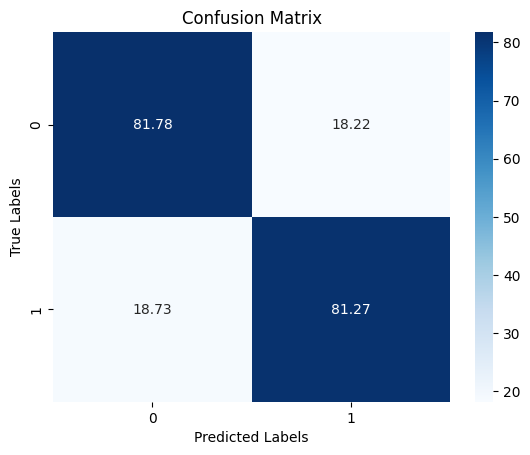

In [37]:
from sklearn.metrics import confusion_matrix

matrix = confusion_matrix(target_validate, logisticRe_predictions)
matrix_percentages = matrix / matrix.sum(axis=1, keepdims=True) * 100

sns.heatmap(matrix_percentages, annot=True, fmt='.2f', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [38]:
#accuracy score
accuracy_score(target_validate, logisticRe_predictions)

0.8149954282231027

# **Model Training with Decision Trees**

In [39]:
from sklearn.tree import DecisionTreeClassifier

model_decisionTree = DecisionTreeClassifier()
model_decisionTree.fit(train_df[all_columns], target_train)

DecisionTreeClassifier()

In [40]:
decitionTree_predictions = model_decisionTree.predict(validate_df[all_columns])

**Confution Matrix**

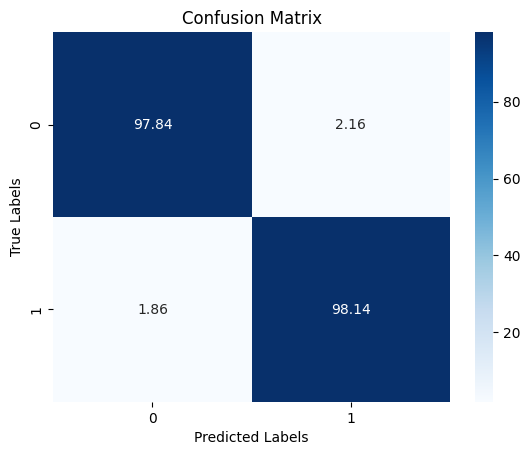

In [41]:
matrix = confusion_matrix(target_validate, decitionTree_predictions)
matrix_percentages = matrix / matrix.sum(axis=1, keepdims=True) * 100

sns.heatmap(matrix_percentages, annot=True, fmt='.2f', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [42]:
accuracy_score(target_validate, decitionTree_predictions)

0.9800445948764016

**Predict for test data and add into csv**

In [43]:
test_df = pd.read_csv('test.csv')

In [ ]:
test_df[numerical_columns] = imputer.transform(test_df[numerical_columns])
test_df[numerical_columns] = scaler.transform(test_df[numerical_columns])
test_df[encoded_categorical_columns] = encoder.transform(test_df[categorical_columns])

In [ ]:
test_predictions = model_decisionTree.predict(test_df[all_columns])

In [ ]:
predictions = {'id': test_df['id'],
               'class': test_predictions}

predictions = pd.DataFrame(predictions).set_index('id')

In [ ]:
predictions.to_csv('predictions.csv')